In [1]:
import sys
from pathlib import Path

try:
    notebook_path = Path(__file__).resolve()
    project_root = notebook_path.parents[4]
except NameError:
    project_root = Path.cwd().parents[3]

sys.path.insert(0, str(project_root))
print("Project root added to sys.path:", project_root)

# load data
from processor import Qasper

Project root added to sys.path: c:\Users\USER\BDC800-Capstone


c:\Users\USER\BDC800-Capstone\.venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Configuration file not found at core/configs/logging.yaml
Using default logging configuration


In [2]:
# Load data
qasper_ds = Qasper()
qasper_ds.load()

In [3]:
# get list of documents
docs = list(qasper_ds.get_documents())

# get list of question answer pairs
qas = list(qasper_ds.get_queries())

In [8]:
print(docs)

[Document(id='1909.00694', content='Affective events BIBREF0 are events that typically affect people in positive or negative ways. For example, getting money and playing sports are usually positive to the experiencers; catching cold and losing one\'s wallet are negative. Understanding affective events is important to various natural language processing (NLP) applications such as dialogue systems BIBREF1, question-answering systems BIBREF2, and humor recognition BIBREF3. In this paper, we work on recognizing the polarity of an affective event that is represented by a score ranging from $-1$ (negative) to 1 (positive). Learning affective events is challenging because, as the examples above suggest, the polarity of an event is not necessarily predictable from its constituent words. Combined with the unbounded combinatorial nature of language, the non-compositionality of affective polarity entails the need for large amounts of world knowledge, which can hardly be learned from small annotat

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\USER\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\USER\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\USER\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


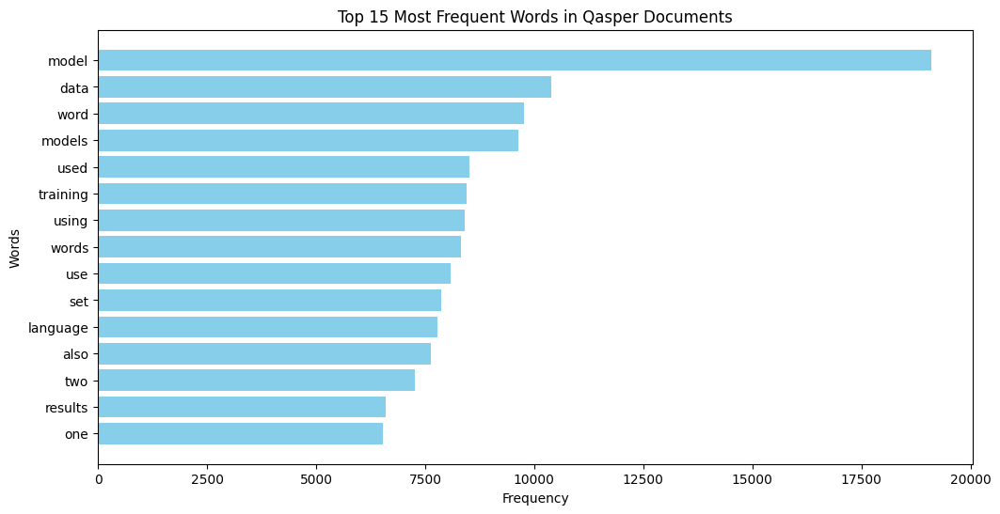

In [15]:
# Re-import necessary libraries since execution state was reset
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string
from collections import Counter
import pandas as pd
import matplotlib.pyplot as plt

# Ensure necessary resources are downloaded
nltk.download('punkt')
nltk.download('punkt_tab')
nltk.download('stopwords')


# Extract content from all documents
all_doc_content = " ".join(doc.content for doc in docs)


# Text Preprocessing Function
def preprocess_text(text):
    """Cleans text, removes punctuation, converts to lowercase, tokenizes, and removes stopwords."""
    cleaned_text = text.translate(str.maketrans("", "", string.punctuation)).lower()
    tokens = word_tokenize(cleaned_text)  # Tokenization
    
    stop_words = set(stopwords.words("english"))  # Load NLTK stopwords
    filtered_tokens = [word for word in tokens if word.isalpha() and word not in stop_words]
    
    return Counter(filtered_tokens)  # Return word frequency

# Process document content
doc_word_freq = preprocess_text(all_doc_content)

# Convert to DataFrame for visualization
df_doc_word_freq = pd.DataFrame(doc_word_freq.items(), columns=['Word', 'Frequency']).sort_values(by='Frequency', ascending=False)
df_doc_word_freq.head(15)

# Plot the top 15 most frequent words
plt.figure(figsize=(12, 6))
plt.barh(df_doc_word_freq.head(15)['Word'], df_doc_word_freq.head(15)['Frequency'], color='skyblue')
plt.xlabel("Frequency")
plt.ylabel("Words")
plt.title("Top 15 Most Frequent Words in Qasper Documents")
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.show()


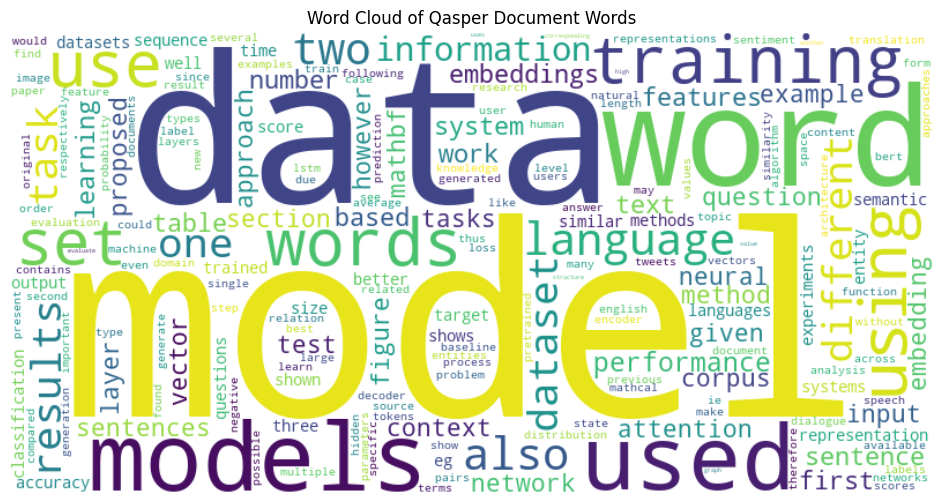

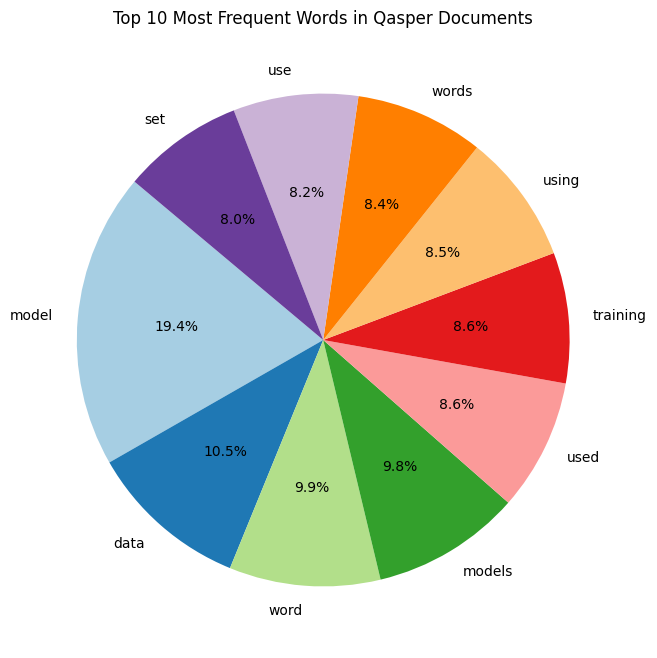

In [18]:
# 1. Word Cloud
from wordcloud import WordCloud

plt.figure(figsize=(12, 6))
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(doc_word_freq)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.title("Word Cloud of Qasper Document Words")
plt.show()

# .2 Pie Chart of the Top 10 Words
top_10_words = df_doc_word_freq.head(10)
plt.figure(figsize=(8, 8))
plt.pie(top_10_words['Frequency'], labels=top_10_words['Word'], autopct='%1.1f%%', startangle=140, colors=plt.cm.Paired.colors)
plt.title("Top 10 Most Frequent Words in Qasper Documents")
plt.show()
